## Getting Started

With the necessary background out of the way, let's get started. For this notebook, we will work with a subset of the data consisting of 10000 rows. Hyperparameter tuning is extremely computationally expensive and working with the full dataset in a Kaggle Kernel would not be feasible for more than a few search iterations. However, the same ideas that we will implement here can be applied to the full dataset and while this notebook is specifically aimed at the GBM, the methods can be applied for any machine learning model.

To "test" the tuning results, we will save some of the training data, 6000 rows, as a separate testing set. When we do hyperparameter tuning, it's crucial to **not tune the hyperparameters on the testing data**. We can only use the testing data a **single time** when we evaluate the final model that has been tuned on the validation data. To actually test our methods from this notebook, we would need to train the best model on all of the training data, make predictions on the actual testing data, and then submit our answers to the competition.

In [1]:
# Data manipulation
import pandas as pd
import numpy as np

# Modeling
import lightgbm as lgb

# Splitting data
from sklearn.model_selection import train_test_split

N_FOLDS = 5
MAX_EVALS = 5

In [23]:
features = pd.read_csv('../dataset/application_train.csv')
features = features.sample(16000, random_state=1)

In [24]:
features.columns

Index(['SK_ID_CURR', 'TARGET', 'NAME_CONTRACT_TYPE', 'CODE_GENDER',
       'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'CNT_CHILDREN', 'AMT_INCOME_TOTAL',
       'AMT_CREDIT', 'AMT_ANNUITY',
       ...
       'FLAG_DOCUMENT_18', 'FLAG_DOCUMENT_19', 'FLAG_DOCUMENT_20',
       'FLAG_DOCUMENT_21', 'AMT_REQ_CREDIT_BUREAU_HOUR',
       'AMT_REQ_CREDIT_BUREAU_DAY', 'AMT_REQ_CREDIT_BUREAU_WEEK',
       'AMT_REQ_CREDIT_BUREAU_MON', 'AMT_REQ_CREDIT_BUREAU_QRT',
       'AMT_REQ_CREDIT_BUREAU_YEAR'],
      dtype='object', length=122)

In [30]:
# Only numeric features
features = features.select_dtypes('number')
features = features.drop(columns=['TARGET', 'SK_ID_CURR'])

In [31]:
features.columns

Index(['CNT_CHILDREN', 'AMT_INCOME_TOTAL', 'AMT_CREDIT', 'AMT_ANNUITY',
       'AMT_GOODS_PRICE', 'REGION_POPULATION_RELATIVE', 'DAYS_BIRTH',
       'DAYS_EMPLOYED', 'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH',
       ...
       'FLAG_DOCUMENT_18', 'FLAG_DOCUMENT_19', 'FLAG_DOCUMENT_20',
       'FLAG_DOCUMENT_21', 'AMT_REQ_CREDIT_BUREAU_HOUR',
       'AMT_REQ_CREDIT_BUREAU_DAY', 'AMT_REQ_CREDIT_BUREAU_WEEK',
       'AMT_REQ_CREDIT_BUREAU_MON', 'AMT_REQ_CREDIT_BUREAU_QRT',
       'AMT_REQ_CREDIT_BUREAU_YEAR'],
      dtype='object', length=104)

In [33]:
# labels = np.array(features['TARGET'].astype(np.int32)).reshape(-1,)
labels

array([1, 0, 0, ..., 0, 0, 0])

In [34]:
labels.shape

(16000,)

In [35]:
# Split into training and testing data
train_features, test_features, train_labels, test_labels = train_test_split(features, labels, test_size=6000)

In [36]:
train_features.shape, test_features.shape

((10000, 104), (6000, 104))

We will also use only the numeric features to reduce the number of dimensions which will help speed up the hyperparameter search. Again, this is something we would not want to do on a real problem, but for demonstration purposes, it will allow us to see the concepts in practice (rather than waiting days/months for the search to finish).

In [37]:
train_set = lgb.Dataset(data=train_features, label=train_labels)
test_set = lgb.Dataset(data=test_features, label=test_labels)

In [38]:
model = lgb.LGBMClassifier()

In [40]:
default_params = model.get_params()
del default_params['n_estimators']

In [59]:
cv_result = lgb.cv(default_params, train_set, num_boost_round=1000, early_stopping_rounds=100, metrics='auc', nfold=N_FOLDS)

In [60]:
print(
    'The maximum validation ROC AUC was: {:.5f} with a standard deviation of {:.5f}.'.format(
        cv_result['auc-mean'][-1], cv_result['auc-stdv'][-1]))

The maximum validation ROC AUC was: 0.71407 with a standard deviation of 0.01947.


We can use this result as a baseline model to beat. To find out how well the model does on our "test" data, we will retrain it on all the training data with the best number of estimators found during cross validation with early stopping.

In [62]:
from sklearn.metrics import roc_auc_score

In [65]:
model.n_estimators = len(cv_result['auc-mean'])

In [66]:
# Train and make predicions with model
model.fit(train_features, train_labels)

LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
        learning_rate=0.1, max_depth=-1, min_child_samples=20,
        min_child_weight=0.001, min_split_gain=0.0, n_estimators=24,
        n_jobs=-1, num_leaves=31, objective=None, random_state=None,
        reg_alpha=0.0, reg_lambda=0.0, silent=True, subsample=1.0,
        subsample_for_bin=200000, subsample_freq=0)

In [83]:
preds = model.predict_proba(test_features)[:, 1]
# 与predict不同，predict直接预测出单一值，并不是prob向量

In [84]:
baseline_auc = roc_auc_score(test_labels, preds)

In [86]:
print('The baseline model scores {:.5f} ROC AUC on the test set.'.format(baseline_auc))

The baseline model scores 0.72967 ROC AUC on the test set.


In [88]:
def objective(hyperparameters, iteration):
    # Number of estimators will be found using early stopping
    if 'n_estimators' in hyperparameters.keys():
        del hyperparameters['n_estimators']
    
    cv_result = lgb.cv(hyperparameters, train_set, num_boost_round = 1000, nfold = N_FOLDS, 
                        early_stopping_rounds = 100, metrics = 'auc')
    
    score = cv_result['auc-mean'][-1]
    hyperparameters['n_estimators'] = len(cv_result['auc-mean'])
    
    return score, hyperparameters, iteration

In [89]:
score, params, iteration = objective(default_params, 1)

In [90]:
print('The cross-validation ROC AUC was {:.5f}.'.format(score))

The cross-validation ROC AUC was 0.71407.


## Domain
### Hyperparameters for GBM

In [91]:
# Create a default model
model = lgb.LGBMModel()
model.get_params()

{'boosting_type': 'gbdt',
 'class_weight': None,
 'colsample_bytree': 1.0,
 'learning_rate': 0.1,
 'max_depth': -1,
 'min_child_samples': 20,
 'min_child_weight': 0.001,
 'min_split_gain': 0.0,
 'n_estimators': 100,
 'n_jobs': -1,
 'num_leaves': 31,
 'objective': None,
 'random_state': None,
 'reg_alpha': 0.0,
 'reg_lambda': 0.0,
 'silent': True,
 'subsample': 1.0,
 'subsample_for_bin': 200000,
 'subsample_freq': 0}

In [92]:
# Hyperparameter grid
param_grid = {
    'boosting_type': ['gbdt', 'goss', 'dart'],
    'num_leaves': list(range(20, 150)),
    'learning_rate': list(np.logspace(np.log10(0.005), np.log10(0.5), base = 10, num = 1000)),
    'subsample_for_bin': list(range(20000, 300000, 20000)),
    'min_child_samples': list(range(20, 500, 5)),
    'reg_alpha': list(np.linspace(0, 1)),
    'reg_lambda': list(np.linspace(0, 1)),
    'colsample_bytree': list(np.linspace(0.6, 1, 10)),
    'subsample': list(np.linspace(0.5, 1, 100)),
    'is_unbalance': [True, False]
}

In [96]:
import random
random.seed(50)

In [122]:
boosting_type = random.sample(param_grid['boosting_type'], 1)[0]

subsample = 1.0 if boosting_type == 'goss' else random.sample(param_grid['subsample'], 1)[0]

print('Boosting type: ', boosting_type)
print('Subsample ratio: ', subsample)

Boosting type:  goss
Subsample ratio:  1.0


In [123]:
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline

Text(0.5,1,'Learning Rate Distribution')

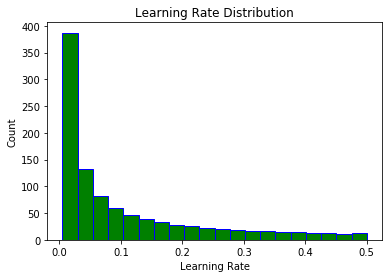

In [129]:
plt.hist(param_grid['learning_rate'], bins=20, color='g', edgecolor='b')
plt.xlabel('Learning Rate')
plt.ylabel('Count')
plt.title('Learning Rate Distribution',)

The learning rate domain is from 0.005 to 0.5. Using a logarithmic uniform distribution allows us to create a domain where there are as many values from 0.005 to 0.05 as from 0.05 to 0.5. In a linear space, there would be far more values from 0.05 to 0.5 because this represents a larger distance in linear space but in logarithmic space each of these two intervals is the same width because they are multiples of 10 of each other. (Think about going from 1 to 10 and then from 10 to 100. On a logarithmic scale, these intervals are the same size, but on a linear scale the latter is 10 times the size of the former). In other words, a logarithmic uniform distribution lets us sample more evenly from a domain that varies over several orders of magnitude.

If that's a little confusing, perhaps the graph above makes it clearer. We can also do a sanity check to make sure the spacing is correct by counting the number of values in each interval.

In [130]:
a = 0
b = 0

# Check number of values in each category
for x in param_grid['learning_rate']:
    # Check values
    if x >= 0.005 and x < 0.05:
        a += 1
    elif x >= 0.05 and x < 0.5:
        b += 1

print('There are {} values between 0.005 and 0.05'.format(a))
print('There are {} values between 0.05 and 0.5'.format(b))

There are 499 values between 0.005 and 0.05
There are 499 values between 0.05 and 0.5


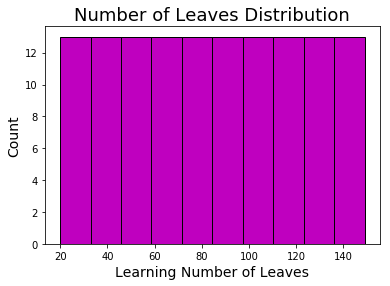

In [131]:
# number of leaves domain
plt.hist(param_grid['num_leaves'], color = 'm', edgecolor = 'k')
plt.xlabel('Learning Number of Leaves', size = 14); plt.ylabel('Count', size = 14); plt.title('Number of Leaves Distribution', size = 18);

## Algorithm for selecting next values

In [132]:
# Dataframes for random and grid search
random_results = pd.DataFrame(columns = ['score', 'params', 'iteration'],
                              index = list(range(MAX_EVALS)))

grid_results = pd.DataFrame(columns = ['score', 'params', 'iteration'],
                              index = list(range(MAX_EVALS)))

In [135]:
com = 1
for x in param_grid.values():
    com *= len(x)
print('There are {} combinations'.format(com))

There are 2620800000000000 combinations


In [136]:
import itertools

In [ ]:
def grid_search(param_grid, max_evals = MAX_EVALS):
    """Grid search algorithm (with limit on max evals)"""
    
    # Dataframe to store results
    results = pd.DataFrame(columns = ['score', 'params', 'iteration'],
                              index = list(range(MAX_EVALS)))
    keys, values = zip(*param_grid.items())

In [146]:
i = 0

In [147]:
 keys, values = zip(*param_grid.items())

In [ ]:
for v in itertools.product(*values):
    print(v)

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.0, 0.6, 0.5, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.0, 0.6, 0.5, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.0, 0.6, 0.5050505050505051, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.0, 0.6, 0.5050505050505051, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.0, 0.6, 0.51010101010101, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.0, 0.6, 0.51010101010101, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.0, 0.6, 0.5151515151515151, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.0, 0.6, 0.5151515151515151, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.0, 0.6, 0.5202020202020202, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.0, 0.6, 0.5202020202020202, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.0, 0.6, 0.5252525252525253, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.0, 0.6, 0.525252525

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.0, 0.9111111111111111, 1.0, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.0, 0.9555555555555555, 0.5, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.0, 0.9555555555555555, 0.5, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.0, 0.9555555555555555, 0.5050505050505051, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.0, 0.9555555555555555, 0.5050505050505051, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.0, 0.9555555555555555, 0.51010101010101, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.0, 0.9555555555555555, 0.51010101010101, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.0, 0.9555555555555555, 0.5151515151515151, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.0, 0.9555555555555555, 0.5151515151515151, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.0, 0.9555555555555555, 0.5202020202020202, True)
('gbdt', 20, 0.004999999

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.02040816326530612, 0.9111111111111111, 1.0, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.02040816326530612, 0.9111111111111111, 1.0, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.02040816326530612, 0.9555555555555555, 0.5, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.02040816326530612, 0.9555555555555555, 0.5, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.02040816326530612, 0.9555555555555555, 0.5050505050505051, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.02040816326530612, 0.9555555555555555, 0.5050505050505051, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.02040816326530612, 0.9555555555555555, 0.51010101010101, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.02040816326530612, 0.9555555555555555, 0.51010101010101, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.02040816326530612, 0.9555555555555555, 0.5151515151515151, True

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.04081632653061224, 0.9111111111111111, 1.0, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.04081632653061224, 0.9111111111111111, 1.0, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.04081632653061224, 0.9555555555555555, 0.5, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.04081632653061224, 0.9555555555555555, 0.5, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.04081632653061224, 0.9555555555555555, 0.5050505050505051, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.04081632653061224, 0.9555555555555555, 0.5050505050505051, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.04081632653061224, 0.9555555555555555, 0.51010101010101, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.04081632653061224, 0.9555555555555555, 0.51010101010101, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.04081632653061224, 0.9555555555555555, 0.5151515151515151, True

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.061224489795918366, 0.9111111111111111, 0.994949494949495, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.061224489795918366, 0.9111111111111111, 1.0, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.061224489795918366, 0.9111111111111111, 1.0, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.061224489795918366, 0.9555555555555555, 0.5, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.061224489795918366, 0.9555555555555555, 0.5, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.061224489795918366, 0.9555555555555555, 0.5050505050505051, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.061224489795918366, 0.9555555555555555, 0.5050505050505051, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.061224489795918366, 0.9555555555555555, 0.51010101010101, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.061224489795918366, 0.9555555555555555, 0.510101010101

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.08163265306122448, 0.9111111111111111, 0.994949494949495, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.08163265306122448, 0.9111111111111111, 1.0, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.08163265306122448, 0.9111111111111111, 1.0, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.08163265306122448, 0.9555555555555555, 0.5, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.08163265306122448, 0.9555555555555555, 0.5, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.08163265306122448, 0.9555555555555555, 0.5050505050505051, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.08163265306122448, 0.9555555555555555, 0.5050505050505051, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.08163265306122448, 0.9555555555555555, 0.51010101010101, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.08163265306122448, 0.9555555555555555, 0.51010101010101, False

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.12244897959183673, 0.6, 0.7424242424242424, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.12244897959183673, 0.6, 0.7424242424242424, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.12244897959183673, 0.6, 0.7474747474747475, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.12244897959183673, 0.6, 0.7474747474747475, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.12244897959183673, 0.6, 0.7525252525252526, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.12244897959183673, 0.6, 0.7525252525252526, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.12244897959183673, 0.6, 0.7575757575757576, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.12244897959183673, 0.6, 0.7575757575757576, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.12244897959183673, 0.6, 0.7626262626262627, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.1224489795918367

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.14285714285714285, 0.6, 0.7424242424242424, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.14285714285714285, 0.6, 0.7424242424242424, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.14285714285714285, 0.6, 0.7474747474747475, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.14285714285714285, 0.6, 0.7474747474747475, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.14285714285714285, 0.6, 0.7525252525252526, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.14285714285714285, 0.6, 0.7525252525252526, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.14285714285714285, 0.6, 0.7575757575757576, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.14285714285714285, 0.6, 0.7575757575757576, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.14285714285714285, 0.6, 0.7626262626262627, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.1428571428571428

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.14285714285714285, 0.9111111111111111, 0.98989898989899, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.14285714285714285, 0.9111111111111111, 0.994949494949495, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.14285714285714285, 0.9111111111111111, 0.994949494949495, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.14285714285714285, 0.9111111111111111, 1.0, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.14285714285714285, 0.9111111111111111, 1.0, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.14285714285714285, 0.9555555555555555, 0.5, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.14285714285714285, 0.9555555555555555, 0.5, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.14285714285714285, 0.9555555555555555, 0.5050505050505051, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.14285714285714285, 0.9555555555555555, 0.5050505050505051, Fals

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.16326530612244897, 0.9111111111111111, 0.98989898989899, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.16326530612244897, 0.9111111111111111, 0.994949494949495, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.16326530612244897, 0.9111111111111111, 0.994949494949495, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.16326530612244897, 0.9111111111111111, 1.0, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.16326530612244897, 0.9111111111111111, 1.0, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.16326530612244897, 0.9555555555555555, 0.5, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.16326530612244897, 0.9555555555555555, 0.5, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.16326530612244897, 0.9555555555555555, 0.5050505050505051, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.16326530612244897, 0.9555555555555555, 0.5050505050505051, Fals

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.18367346938775508, 0.8222222222222222, 0.7373737373737375, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.18367346938775508, 0.8222222222222222, 0.7373737373737375, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.18367346938775508, 0.8222222222222222, 0.7424242424242424, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.18367346938775508, 0.8222222222222222, 0.7424242424242424, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.18367346938775508, 0.8222222222222222, 0.7474747474747475, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.18367346938775508, 0.8222222222222222, 0.7474747474747475, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.18367346938775508, 0.8222222222222222, 0.7525252525252526, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.18367346938775508, 0.8222222222222222, 0.7525252525252526, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.2040816326530612, 0.8222222222222222, 0.7373737373737375, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.2040816326530612, 0.8222222222222222, 0.7373737373737375, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.2040816326530612, 0.8222222222222222, 0.7424242424242424, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.2040816326530612, 0.8222222222222222, 0.7424242424242424, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.2040816326530612, 0.8222222222222222, 0.7474747474747475, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.2040816326530612, 0.8222222222222222, 0.7474747474747475, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.2040816326530612, 0.8222222222222222, 0.7525252525252526, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.2040816326530612, 0.8222222222222222, 0.7525252525252526, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.2040816

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.22448979591836732, 0.6888888888888889, 0.9848484848484849, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.22448979591836732, 0.6888888888888889, 0.98989898989899, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.22448979591836732, 0.6888888888888889, 0.98989898989899, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.22448979591836732, 0.6888888888888889, 0.994949494949495, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.22448979591836732, 0.6888888888888889, 0.994949494949495, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.22448979591836732, 0.6888888888888889, 1.0, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.22448979591836732, 0.6888888888888889, 1.0, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.22448979591836732, 0.7333333333333333, 0.5, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.22448979591836732, 0.7333333333333333, 0.5, False)

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.2857142857142857, 0.9111111111111111, 0.9848484848484849, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.2857142857142857, 0.9111111111111111, 0.9848484848484849, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.2857142857142857, 0.9111111111111111, 0.98989898989899, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.2857142857142857, 0.9111111111111111, 0.98989898989899, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.2857142857142857, 0.9111111111111111, 0.994949494949495, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.2857142857142857, 0.9111111111111111, 0.994949494949495, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.2857142857142857, 0.9111111111111111, 1.0, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.2857142857142857, 0.9111111111111111, 1.0, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.2857142857142857, 0.9555555555555555, 0.5,

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.3061224489795918, 0.8222222222222222, 0.7272727272727273, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.3061224489795918, 0.8222222222222222, 0.7323232323232324, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.3061224489795918, 0.8222222222222222, 0.7323232323232324, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.3061224489795918, 0.8222222222222222, 0.7373737373737375, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.3061224489795918, 0.8222222222222222, 0.7373737373737375, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.3061224489795918, 0.8222222222222222, 0.7424242424242424, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.3061224489795918, 0.8222222222222222, 0.7424242424242424, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.3061224489795918, 0.8222222222222222, 0.7474747474747475, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.3061224

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.32653061224489793, 0.8222222222222222, 0.7272727272727273, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.32653061224489793, 0.8222222222222222, 0.7272727272727273, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.32653061224489793, 0.8222222222222222, 0.7323232323232324, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.32653061224489793, 0.8222222222222222, 0.7323232323232324, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.32653061224489793, 0.8222222222222222, 0.7373737373737375, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.32653061224489793, 0.8222222222222222, 0.7373737373737375, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.32653061224489793, 0.8222222222222222, 0.7424242424242424, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.32653061224489793, 0.8222222222222222, 0.7424242424242424, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.3469387755102041, 0.6888888888888889, 0.9797979797979799, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.3469387755102041, 0.6888888888888889, 0.9797979797979799, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.3469387755102041, 0.6888888888888889, 0.9848484848484849, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.3469387755102041, 0.6888888888888889, 0.9848484848484849, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.3469387755102041, 0.6888888888888889, 0.98989898989899, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.3469387755102041, 0.6888888888888889, 0.98989898989899, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.3469387755102041, 0.6888888888888889, 0.994949494949495, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.3469387755102041, 0.6888888888888889, 0.994949494949495, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.3469387755102

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.36734693877551017, 0.6, 0.7222222222222222, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.36734693877551017, 0.6, 0.7272727272727273, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.36734693877551017, 0.6, 0.7272727272727273, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.36734693877551017, 0.6, 0.7323232323232324, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.36734693877551017, 0.6, 0.7323232323232324, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.36734693877551017, 0.6, 0.7373737373737375, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.36734693877551017, 0.6, 0.7373737373737375, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.36734693877551017, 0.6, 0.7424242424242424, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.36734693877551017, 0.6, 0.7424242424242424, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.367346938775510

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.3877551020408163, 0.6, 0.7222222222222222, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.3877551020408163, 0.6, 0.7272727272727273, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.3877551020408163, 0.6, 0.7272727272727273, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.3877551020408163, 0.6, 0.7323232323232324, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.3877551020408163, 0.6, 0.7323232323232324, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.3877551020408163, 0.6, 0.7373737373737375, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.3877551020408163, 0.6, 0.7373737373737375, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.3877551020408163, 0.6, 0.7424242424242424, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.3877551020408163, 0.6, 0.7424242424242424, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.3877551020408163, 0.6, 0

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.4081632653061224, 0.6, 0.7222222222222222, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.4081632653061224, 0.6, 0.7222222222222222, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.4081632653061224, 0.6, 0.7272727272727273, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.4081632653061224, 0.6, 0.7272727272727273, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.4081632653061224, 0.6, 0.7323232323232324, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.4081632653061224, 0.6, 0.7323232323232324, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.4081632653061224, 0.6, 0.7373737373737375, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.4081632653061224, 0.6, 0.7373737373737375, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.4081632653061224, 0.6, 0.7424242424242424, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.4081632653061224, 0.6, 0.

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.42857142857142855, 0.6, 0.7222222222222222, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.42857142857142855, 0.6, 0.7222222222222222, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.42857142857142855, 0.6, 0.7272727272727273, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.42857142857142855, 0.6, 0.7272727272727273, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.42857142857142855, 0.6, 0.7323232323232324, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.42857142857142855, 0.6, 0.7323232323232324, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.42857142857142855, 0.6, 0.7373737373737375, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.42857142857142855, 0.6, 0.7373737373737375, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.42857142857142855, 0.6, 0.7424242424242424, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.4285714285714285

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.44897959183673464, 0.6, 0.7171717171717171, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.44897959183673464, 0.6, 0.7222222222222222, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.44897959183673464, 0.6, 0.7222222222222222, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.44897959183673464, 0.6, 0.7272727272727273, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.44897959183673464, 0.6, 0.7272727272727273, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.44897959183673464, 0.6, 0.7323232323232324, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.44897959183673464, 0.6, 0.7323232323232324, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.44897959183673464, 0.6, 0.7373737373737375, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.44897959183673464, 0.6, 0.7373737373737375, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.448979591836734

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.4693877551020408, 0.6, 0.7171717171717171, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.4693877551020408, 0.6, 0.7222222222222222, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.4693877551020408, 0.6, 0.7222222222222222, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.4693877551020408, 0.6, 0.7272727272727273, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.4693877551020408, 0.6, 0.7272727272727273, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.4693877551020408, 0.6, 0.7323232323232324, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.4693877551020408, 0.6, 0.7323232323232324, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.4693877551020408, 0.6, 0.7373737373737375, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.4693877551020408, 0.6, 0.7373737373737375, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.4693877551020408, 0.6, 0

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.4897959183673469, 0.6, 0.7171717171717171, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.4897959183673469, 0.6, 0.7171717171717171, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.4897959183673469, 0.6, 0.7222222222222222, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.4897959183673469, 0.6, 0.7222222222222222, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.4897959183673469, 0.6, 0.7272727272727273, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.4897959183673469, 0.6, 0.7272727272727273, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.4897959183673469, 0.6, 0.7323232323232324, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.4897959183673469, 0.6, 0.7323232323232324, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.4897959183673469, 0.6, 0.7373737373737375, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.4897959183673469, 0.6, 0.

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.5102040816326531, 0.6, 0.7171717171717171, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.5102040816326531, 0.6, 0.7171717171717171, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.5102040816326531, 0.6, 0.7222222222222222, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.5102040816326531, 0.6, 0.7222222222222222, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.5102040816326531, 0.6, 0.7272727272727273, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.5102040816326531, 0.6, 0.7272727272727273, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.5102040816326531, 0.6, 0.7323232323232324, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.5102040816326531, 0.6, 0.7323232323232324, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.5102040816326531, 0.6, 0.7373737373737375, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.5102040816326531, 0.6, 0.

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.5306122448979591, 0.6, 0.7121212121212122, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.5306122448979591, 0.6, 0.7171717171717171, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.5306122448979591, 0.6, 0.7171717171717171, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.5306122448979591, 0.6, 0.7222222222222222, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.5306122448979591, 0.6, 0.7222222222222222, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.5306122448979591, 0.6, 0.7272727272727273, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.5306122448979591, 0.6, 0.7272727272727273, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.5306122448979591, 0.6, 0.7323232323232324, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.5306122448979591, 0.6, 0.7323232323232324, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.5306122448979591, 0.6, 0

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.6122448979591836, 0.8222222222222222, 0.7070707070707071, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.6122448979591836, 0.8222222222222222, 0.7121212121212122, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.6122448979591836, 0.8222222222222222, 0.7121212121212122, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.6122448979591836, 0.8222222222222222, 0.7171717171717171, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.6122448979591836, 0.8222222222222222, 0.7171717171717171, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.6122448979591836, 0.8222222222222222, 0.7222222222222222, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.6122448979591836, 0.8222222222222222, 0.7222222222222222, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.6122448979591836, 0.8222222222222222, 0.7272727272727273, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.6122448

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.6326530612244897, 0.8222222222222222, 0.7070707070707071, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.6326530612244897, 0.8222222222222222, 0.7070707070707071, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.6326530612244897, 0.8222222222222222, 0.7121212121212122, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.6326530612244897, 0.8222222222222222, 0.7121212121212122, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.6326530612244897, 0.8222222222222222, 0.7171717171717171, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.6326530612244897, 0.8222222222222222, 0.7171717171717171, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.6326530612244897, 0.8222222222222222, 0.7222222222222222, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.6326530612244897, 0.8222222222222222, 0.7222222222222222, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.6326530

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.6530612244897959, 0.6888888888888889, 0.9595959595959596, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.6530612244897959, 0.6888888888888889, 0.9595959595959596, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.6530612244897959, 0.6888888888888889, 0.9646464646464648, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.6530612244897959, 0.6888888888888889, 0.9646464646464648, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.6530612244897959, 0.6888888888888889, 0.9696969696969697, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.6530612244897959, 0.6888888888888889, 0.9696969696969697, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.6530612244897959, 0.6888888888888889, 0.9747474747474748, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.6530612244897959, 0.6888888888888889, 0.9747474747474748, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.6530612

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.673469387755102, 0.8222222222222222, 0.702020202020202, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.673469387755102, 0.8222222222222222, 0.7070707070707071, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.673469387755102, 0.8222222222222222, 0.7070707070707071, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.673469387755102, 0.8222222222222222, 0.7121212121212122, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.673469387755102, 0.8222222222222222, 0.7121212121212122, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.673469387755102, 0.8222222222222222, 0.7171717171717171, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.673469387755102, 0.8222222222222222, 0.7171717171717171, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.673469387755102, 0.8222222222222222, 0.7222222222222222, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.673469387755102,

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.6938775510204082, 0.8222222222222222, 0.702020202020202, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.6938775510204082, 0.8222222222222222, 0.7070707070707071, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.6938775510204082, 0.8222222222222222, 0.7070707070707071, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.6938775510204082, 0.8222222222222222, 0.7121212121212122, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.6938775510204082, 0.8222222222222222, 0.7121212121212122, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.6938775510204082, 0.8222222222222222, 0.7171717171717171, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.6938775510204082, 0.8222222222222222, 0.7171717171717171, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.6938775510204082, 0.8222222222222222, 0.7222222222222222, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.69387755

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7142857142857142, 0.8222222222222222, 0.702020202020202, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7142857142857142, 0.8222222222222222, 0.702020202020202, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7142857142857142, 0.8222222222222222, 0.7070707070707071, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7142857142857142, 0.8222222222222222, 0.7070707070707071, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7142857142857142, 0.8222222222222222, 0.7121212121212122, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7142857142857142, 0.8222222222222222, 0.7121212121212122, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7142857142857142, 0.8222222222222222, 0.7171717171717171, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7142857142857142, 0.8222222222222222, 0.7171717171717171, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.714285714

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7346938775510203, 0.8222222222222222, 0.702020202020202, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7346938775510203, 0.8222222222222222, 0.702020202020202, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7346938775510203, 0.8222222222222222, 0.7070707070707071, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7346938775510203, 0.8222222222222222, 0.7070707070707071, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7346938775510203, 0.8222222222222222, 0.7121212121212122, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7346938775510203, 0.8222222222222222, 0.7121212121212122, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7346938775510203, 0.8222222222222222, 0.7171717171717171, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7346938775510203, 0.8222222222222222, 0.7171717171717171, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.734693877

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7551020408163265, 0.8222222222222222, 0.696969696969697, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7551020408163265, 0.8222222222222222, 0.702020202020202, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7551020408163265, 0.8222222222222222, 0.702020202020202, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7551020408163265, 0.8222222222222222, 0.7070707070707071, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7551020408163265, 0.8222222222222222, 0.7070707070707071, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7551020408163265, 0.8222222222222222, 0.7121212121212122, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7551020408163265, 0.8222222222222222, 0.7121212121212122, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7551020408163265, 0.8222222222222222, 0.7171717171717171, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7551020408

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7755102040816326, 0.6888888888888889, 0.9494949494949496, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7755102040816326, 0.6888888888888889, 0.9545454545454546, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7755102040816326, 0.6888888888888889, 0.9545454545454546, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7755102040816326, 0.6888888888888889, 0.9595959595959596, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7755102040816326, 0.6888888888888889, 0.9595959595959596, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7755102040816326, 0.6888888888888889, 0.9646464646464648, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7755102040816326, 0.6888888888888889, 0.9646464646464648, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7755102040816326, 0.6888888888888889, 0.9696969696969697, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7755102

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7959183673469387, 0.6, 0.696969696969697, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7959183673469387, 0.6, 0.696969696969697, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7959183673469387, 0.6, 0.702020202020202, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7959183673469387, 0.6, 0.702020202020202, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7959183673469387, 0.6, 0.7070707070707071, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7959183673469387, 0.6, 0.7070707070707071, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7959183673469387, 0.6, 0.7121212121212122, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7959183673469387, 0.6, 0.7121212121212122, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7959183673469387, 0.6, 0.7171717171717171, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.7959183673469387, 0.6, 0.7171

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8163265306122448, 0.6, 0.696969696969697, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8163265306122448, 0.6, 0.696969696969697, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8163265306122448, 0.6, 0.702020202020202, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8163265306122448, 0.6, 0.702020202020202, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8163265306122448, 0.6, 0.7070707070707071, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8163265306122448, 0.6, 0.7070707070707071, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8163265306122448, 0.6, 0.7121212121212122, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8163265306122448, 0.6, 0.7121212121212122, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8163265306122448, 0.6, 0.7171717171717171, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8163265306122448, 0.6, 0.7171

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8163265306122448, 0.9111111111111111, 0.9444444444444444, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8163265306122448, 0.9111111111111111, 0.9494949494949496, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8163265306122448, 0.9111111111111111, 0.9494949494949496, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8163265306122448, 0.9111111111111111, 0.9545454545454546, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8163265306122448, 0.9111111111111111, 0.9545454545454546, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8163265306122448, 0.9111111111111111, 0.9595959595959596, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8163265306122448, 0.9111111111111111, 0.9595959595959596, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8163265306122448, 0.9111111111111111, 0.9646464646464648, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8163265

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.836734693877551, 0.8222222222222222, 0.6919191919191919, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.836734693877551, 0.8222222222222222, 0.696969696969697, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.836734693877551, 0.8222222222222222, 0.696969696969697, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.836734693877551, 0.8222222222222222, 0.702020202020202, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.836734693877551, 0.8222222222222222, 0.702020202020202, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.836734693877551, 0.8222222222222222, 0.7070707070707071, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.836734693877551, 0.8222222222222222, 0.7070707070707071, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.836734693877551, 0.8222222222222222, 0.7121212121212122, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.836734693877551, 0.

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8571428571428571, 0.6888888888888889, 0.9444444444444444, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8571428571428571, 0.6888888888888889, 0.9444444444444444, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8571428571428571, 0.6888888888888889, 0.9494949494949496, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8571428571428571, 0.6888888888888889, 0.9494949494949496, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8571428571428571, 0.6888888888888889, 0.9545454545454546, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8571428571428571, 0.6888888888888889, 0.9545454545454546, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8571428571428571, 0.6888888888888889, 0.9595959595959596, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8571428571428571, 0.6888888888888889, 0.9595959595959596, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8571428

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8775510204081632, 0.6888888888888889, 0.9444444444444444, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8775510204081632, 0.6888888888888889, 0.9444444444444444, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8775510204081632, 0.6888888888888889, 0.9494949494949496, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8775510204081632, 0.6888888888888889, 0.9494949494949496, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8775510204081632, 0.6888888888888889, 0.9545454545454546, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8775510204081632, 0.6888888888888889, 0.9545454545454546, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8775510204081632, 0.6888888888888889, 0.9595959595959596, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8775510204081632, 0.6888888888888889, 0.9595959595959596, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8775510

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8979591836734693, 0.6888888888888889, 0.9393939393939394, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8979591836734693, 0.6888888888888889, 0.9444444444444444, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8979591836734693, 0.6888888888888889, 0.9444444444444444, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8979591836734693, 0.6888888888888889, 0.9494949494949496, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8979591836734693, 0.6888888888888889, 0.9494949494949496, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8979591836734693, 0.6888888888888889, 0.9545454545454546, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8979591836734693, 0.6888888888888889, 0.9545454545454546, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8979591836734693, 0.6888888888888889, 0.9595959595959596, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.8979591

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.9183673469387754, 0.6888888888888889, 0.8484848484848485, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.9183673469387754, 0.6888888888888889, 0.8535353535353536, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.9183673469387754, 0.6888888888888889, 0.8535353535353536, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.9183673469387754, 0.6888888888888889, 0.8585858585858586, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.9183673469387754, 0.6888888888888889, 0.8585858585858586, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.9183673469387754, 0.6888888888888889, 0.8636363636363636, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.9183673469387754, 0.6888888888888889, 0.8636363636363636, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.9183673469387754, 0.6888888888888889, 0.8686868686868687, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.9183673

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.9387755102040816, 0.6888888888888889, 0.9393939393939394, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.9387755102040816, 0.6888888888888889, 0.9393939393939394, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.9387755102040816, 0.6888888888888889, 0.9444444444444444, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.9387755102040816, 0.6888888888888889, 0.9444444444444444, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.9387755102040816, 0.6888888888888889, 0.9494949494949496, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.9387755102040816, 0.6888888888888889, 0.9494949494949496, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.9387755102040816, 0.6888888888888889, 0.9545454545454546, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.9387755102040816, 0.6888888888888889, 0.9545454545454546, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.9387755

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.9591836734693877, 0.6888888888888889, 0.9393939393939394, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.9591836734693877, 0.6888888888888889, 0.9393939393939394, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.9591836734693877, 0.6888888888888889, 0.9444444444444444, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.9591836734693877, 0.6888888888888889, 0.9444444444444444, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.9591836734693877, 0.6888888888888889, 0.9494949494949496, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.9591836734693877, 0.6888888888888889, 0.9494949494949496, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.9591836734693877, 0.6888888888888889, 0.9545454545454546, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.9591836734693877, 0.6888888888888889, 0.9545454545454546, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.9591836

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.9795918367346939, 0.6888888888888889, 0.9343434343434344, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.9795918367346939, 0.6888888888888889, 0.9393939393939394, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.9795918367346939, 0.6888888888888889, 0.9393939393939394, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.9795918367346939, 0.6888888888888889, 0.9444444444444444, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.9795918367346939, 0.6888888888888889, 0.9444444444444444, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.9795918367346939, 0.6888888888888889, 0.9494949494949496, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.9795918367346939, 0.6888888888888889, 0.9494949494949496, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.9795918367346939, 0.6888888888888889, 0.9545454545454546, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 0.9795918

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 1.0, 0.6888888888888889, 0.9343434343434344, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 1.0, 0.6888888888888889, 0.9393939393939394, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 1.0, 0.6888888888888889, 0.9393939393939394, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 1.0, 0.6888888888888889, 0.9444444444444444, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 1.0, 0.6888888888888889, 0.9444444444444444, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 1.0, 0.6888888888888889, 0.9494949494949496, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 1.0, 0.6888888888888889, 0.9494949494949496, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 1.0, 0.6888888888888889, 0.9545454545454546, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 1.0, 0.6888888888888889, 0.9545454545454546, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0, 1.0, 0.6888888888888889, 0

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.0, 0.6888888888888889, 0.9343434343434344, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.0, 0.6888888888888889, 0.9343434343434344, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.0, 0.6888888888888889, 0.9393939393939394, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.0, 0.6888888888888889, 0.9393939393939394, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.0, 0.6888888888888889, 0.9444444444444444, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.0, 0.6888888888888889, 0.9444444444444444, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.0, 0.6888888888888889, 0.9494949494949496, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.0, 0.6888888888888889, 0.9494949494949496, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0204

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.02040816326530612, 0.6888888888888889, 0.9343434343434344, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.02040816326530612, 0.6888888888888889, 0.9343434343434344, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.02040816326530612, 0.6888888888888889, 0.9393939393939394, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.02040816326530612, 0.6888888888888889, 0.9393939393939394, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.02040816326530612, 0.6888888888888889, 0.9444444444444444, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.02040816326530612, 0.6888888888888889, 0.9444444444444444, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.02040816326530612, 0.6888888888888889, 0.9494949494949496, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.04081632653061224, 0.6, 0.6767676767676768, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.04081632653061224, 0.6, 0.6818181818181819, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.04081632653061224, 0.6, 0.6818181818181819, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.04081632653061224, 0.6, 0.6868686868686869, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.04081632653061224, 0.6, 0.6868686868686869, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.04081632653061224, 0.6, 0.6919191919191919, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.04081632653061224, 0.6, 0.6919191919191919, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.04081632653061224, 0.6, 0.696969696969697, True)
('gbdt', 20, 0.004999999999999999, 20000, 20,

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.061224489795918366, 0.6, 0.6767676767676768, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.061224489795918366, 0.6, 0.6818181818181819, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.061224489795918366, 0.6, 0.6818181818181819, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.061224489795918366, 0.6, 0.6868686868686869, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.061224489795918366, 0.6, 0.6868686868686869, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.061224489795918366, 0.6, 0.6919191919191919, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.061224489795918366, 0.6, 0.6919191919191919, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.061224489795918366, 0.6, 0.696969696969697, True)
('gbdt', 20, 0.004999999999999999, 20

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.12244897959183673, 0.9111111111111111, 0.9242424242424243, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.12244897959183673, 0.9111111111111111, 0.9292929292929293, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.12244897959183673, 0.9111111111111111, 0.9292929292929293, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.12244897959183673, 0.9111111111111111, 0.9343434343434344, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.12244897959183673, 0.9111111111111111, 0.9343434343434344, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.12244897959183673, 0.9111111111111111, 0.9393939393939394, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.12244897959183673, 0.9111111111111111, 0.9393939393939394, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0204081632

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.14285714285714285, 0.9111111111111111, 0.9242424242424243, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.14285714285714285, 0.9111111111111111, 0.9242424242424243, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.14285714285714285, 0.9111111111111111, 0.9292929292929293, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.14285714285714285, 0.9111111111111111, 0.9292929292929293, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.14285714285714285, 0.9111111111111111, 0.9343434343434344, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.14285714285714285, 0.9111111111111111, 0.9343434343434344, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.14285714285714285, 0.9111111111111111, 0.9393939393939394, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.16326530612244897, 0.9111111111111111, 0.9242424242424243, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.16326530612244897, 0.9111111111111111, 0.9242424242424243, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.16326530612244897, 0.9111111111111111, 0.9292929292929293, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.16326530612244897, 0.9111111111111111, 0.9292929292929293, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.16326530612244897, 0.9111111111111111, 0.9343434343434344, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.16326530612244897, 0.9111111111111111, 0.9343434343434344, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.16326530612244897, 0.9111111111111111, 0.9393939393939394, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.18367346938775508, 0.9111111111111111, 0.9191919191919192, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.18367346938775508, 0.9111111111111111, 0.9242424242424243, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.18367346938775508, 0.9111111111111111, 0.9242424242424243, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.18367346938775508, 0.9111111111111111, 0.9292929292929293, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.18367346938775508, 0.9111111111111111, 0.9292929292929293, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.18367346938775508, 0.9111111111111111, 0.9343434343434344, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.18367346938775508, 0.9111111111111111, 0.9343434343434344, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0204081632

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.2040816326530612, 0.9111111111111111, 0.9191919191919192, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.2040816326530612, 0.9111111111111111, 0.9242424242424243, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.2040816326530612, 0.9111111111111111, 0.9242424242424243, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.2040816326530612, 0.9111111111111111, 0.9292929292929293, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.2040816326530612, 0.9111111111111111, 0.9292929292929293, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.2040816326530612, 0.9111111111111111, 0.9343434343434344, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.2040816326530612, 0.9111111111111111, 0.9343434343434344, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.22448979591836732, 0.7333333333333333, 0.8585858585858586, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.22448979591836732, 0.7333333333333333, 0.8585858585858586, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.22448979591836732, 0.7333333333333333, 0.8636363636363636, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.22448979591836732, 0.7333333333333333, 0.8636363636363636, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.22448979591836732, 0.7333333333333333, 0.8686868686868687, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.22448979591836732, 0.7333333333333333, 0.8686868686868687, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.22448979591836732, 0.7333333333333333, 0.8737373737373737, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.24489795918367346, 0.6, 0.6666666666666667, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.24489795918367346, 0.6, 0.6666666666666667, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.24489795918367346, 0.6, 0.6717171717171717, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.24489795918367346, 0.6, 0.6717171717171717, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.24489795918367346, 0.6, 0.6767676767676768, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.24489795918367346, 0.6, 0.6767676767676768, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.24489795918367346, 0.6, 0.6818181818181819, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.24489795918367346, 0.6, 0.6818181818181819, False)
('gbdt', 20, 0.004999999999999999, 20000, 20

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.26530612244897955, 0.6, 0.6616161616161617, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.26530612244897955, 0.6, 0.6666666666666667, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.26530612244897955, 0.6, 0.6666666666666667, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.26530612244897955, 0.6, 0.6717171717171717, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.26530612244897955, 0.6, 0.6717171717171717, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.26530612244897955, 0.6, 0.6767676767676768, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.26530612244897955, 0.6, 0.6767676767676768, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.26530612244897955, 0.6, 0.6818181818181819, True)
('gbdt', 20, 0.004999999999999999, 20000, 20

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.2857142857142857, 0.6, 0.6616161616161617, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.2857142857142857, 0.6, 0.6666666666666667, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.2857142857142857, 0.6, 0.6666666666666667, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.2857142857142857, 0.6, 0.6717171717171717, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.2857142857142857, 0.6, 0.6717171717171717, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.2857142857142857, 0.6, 0.6767676767676768, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.2857142857142857, 0.6, 0.6767676767676768, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.2857142857142857, 0.6, 0.6818181818181819, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0204

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.3061224489795918, 0.6, 0.6616161616161617, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.3061224489795918, 0.6, 0.6616161616161617, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.3061224489795918, 0.6, 0.6666666666666667, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.3061224489795918, 0.6, 0.6666666666666667, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.3061224489795918, 0.6, 0.6717171717171717, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.3061224489795918, 0.6, 0.6717171717171717, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.3061224489795918, 0.6, 0.6767676767676768, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.3061224489795918, 0.6, 0.6767676767676768, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0204

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.32653061224489793, 0.6, 0.6616161616161617, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.32653061224489793, 0.6, 0.6616161616161617, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.32653061224489793, 0.6, 0.6666666666666667, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.32653061224489793, 0.6, 0.6666666666666667, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.32653061224489793, 0.6, 0.6717171717171717, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.32653061224489793, 0.6, 0.6717171717171717, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.32653061224489793, 0.6, 0.6767676767676768, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.32653061224489793, 0.6, 0.6767676767676768, False)
('gbdt', 20, 0.004999999999999999, 20000, 20

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.4081632653061224, 0.6, 0.6565656565656566, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.4081632653061224, 0.6, 0.6565656565656566, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.4081632653061224, 0.6, 0.6616161616161617, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.4081632653061224, 0.6, 0.6616161616161617, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.4081632653061224, 0.6, 0.6666666666666667, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.4081632653061224, 0.6, 0.6666666666666667, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.4081632653061224, 0.6, 0.6717171717171717, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.4081632653061224, 0.6, 0.6717171717171717, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0204

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.42857142857142855, 0.6, 0.6515151515151515, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.42857142857142855, 0.6, 0.6565656565656566, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.42857142857142855, 0.6, 0.6565656565656566, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.42857142857142855, 0.6, 0.6616161616161617, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.42857142857142855, 0.6, 0.6616161616161617, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.42857142857142855, 0.6, 0.6666666666666667, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.42857142857142855, 0.6, 0.6666666666666667, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.42857142857142855, 0.6, 0.6717171717171717, True)
('gbdt', 20, 0.004999999999999999, 20000, 20

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.42857142857142855, 0.9111111111111111, 0.9040404040404041, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.42857142857142855, 0.9111111111111111, 0.9090909090909092, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.42857142857142855, 0.9111111111111111, 0.9090909090909092, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.42857142857142855, 0.9111111111111111, 0.9141414141414141, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.42857142857142855, 0.9111111111111111, 0.9141414141414141, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.42857142857142855, 0.9111111111111111, 0.9191919191919192, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.42857142857142855, 0.9111111111111111, 0.9191919191919192, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0204081632

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.44897959183673464, 0.9111111111111111, 0.9040404040404041, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.44897959183673464, 0.9111111111111111, 0.9040404040404041, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.44897959183673464, 0.9111111111111111, 0.9090909090909092, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.44897959183673464, 0.9111111111111111, 0.9090909090909092, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.44897959183673464, 0.9111111111111111, 0.9141414141414141, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.44897959183673464, 0.9111111111111111, 0.9141414141414141, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.44897959183673464, 0.9111111111111111, 0.9191919191919192, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.4693877551020408, 0.9111111111111111, 0.9040404040404041, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.4693877551020408, 0.9111111111111111, 0.9040404040404041, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.4693877551020408, 0.9111111111111111, 0.9090909090909092, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.4693877551020408, 0.9111111111111111, 0.9090909090909092, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.4693877551020408, 0.9111111111111111, 0.9141414141414141, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.4693877551020408, 0.9111111111111111, 0.9141414141414141, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.4693877551020408, 0.9111111111111111, 0.9191919191919192, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612,

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.4897959183673469, 0.9111111111111111, 0.898989898989899, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.4897959183673469, 0.9111111111111111, 0.9040404040404041, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.4897959183673469, 0.9111111111111111, 0.9040404040404041, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.4897959183673469, 0.9111111111111111, 0.9090909090909092, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.4897959183673469, 0.9111111111111111, 0.9090909090909092, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.4897959183673469, 0.9111111111111111, 0.9141414141414141, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.4897959183673469, 0.9111111111111111, 0.9141414141414141, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612,

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.5102040816326531, 0.9111111111111111, 0.898989898989899, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.5102040816326531, 0.9111111111111111, 0.9040404040404041, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.5102040816326531, 0.9111111111111111, 0.9040404040404041, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.5102040816326531, 0.9111111111111111, 0.9090909090909092, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.5102040816326531, 0.9111111111111111, 0.9090909090909092, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.5102040816326531, 0.9111111111111111, 0.9141414141414141, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.5102040816326531, 0.9111111111111111, 0.9141414141414141, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612,

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.5306122448979591, 0.9111111111111111, 0.898989898989899, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.5306122448979591, 0.9111111111111111, 0.898989898989899, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.5306122448979591, 0.9111111111111111, 0.9040404040404041, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.5306122448979591, 0.9111111111111111, 0.9040404040404041, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.5306122448979591, 0.9111111111111111, 0.9090909090909092, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.5306122448979591, 0.9111111111111111, 0.9090909090909092, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.5306122448979591, 0.9111111111111111, 0.9141414141414141, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.5510204081632653, 0.9111111111111111, 0.898989898989899, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.5510204081632653, 0.9111111111111111, 0.898989898989899, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.5510204081632653, 0.9111111111111111, 0.9040404040404041, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.5510204081632653, 0.9111111111111111, 0.9040404040404041, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.5510204081632653, 0.9111111111111111, 0.9090909090909092, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.5510204081632653, 0.9111111111111111, 0.9090909090909092, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.5510204081632653, 0.9111111111111111, 0.9141414141414141, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.5714285714285714, 0.8222222222222222, 0.6414141414141414, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.5714285714285714, 0.8222222222222222, 0.6464646464646464, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.5714285714285714, 0.8222222222222222, 0.6464646464646464, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.5714285714285714, 0.8222222222222222, 0.6515151515151515, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.5714285714285714, 0.8222222222222222, 0.6515151515151515, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.5714285714285714, 0.8222222222222222, 0.6565656565656566, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.5714285714285714, 0.8222222222222222, 0.6565656565656566, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.5918367346938775, 0.6888888888888889, 0.893939393939394, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.5918367346938775, 0.6888888888888889, 0.898989898989899, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.5918367346938775, 0.6888888888888889, 0.898989898989899, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.5918367346938775, 0.6888888888888889, 0.9040404040404041, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.5918367346938775, 0.6888888888888889, 0.9040404040404041, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.5918367346938775, 0.6888888888888889, 0.9090909090909092, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.5918367346938775, 0.6888888888888889, 0.9090909090909092, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6122448979591836, 0.6, 0.6414141414141414, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6122448979591836, 0.6, 0.6414141414141414, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6122448979591836, 0.6, 0.6464646464646464, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6122448979591836, 0.6, 0.6464646464646464, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6122448979591836, 0.6, 0.6515151515151515, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6122448979591836, 0.6, 0.6515151515151515, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6122448979591836, 0.6, 0.6565656565656566, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6122448979591836, 0.6, 0.6565656565656566, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0204

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6326530612244897, 0.6, 0.6414141414141414, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6326530612244897, 0.6, 0.6414141414141414, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6326530612244897, 0.6, 0.6464646464646464, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6326530612244897, 0.6, 0.6464646464646464, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6326530612244897, 0.6, 0.6515151515151515, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6326530612244897, 0.6, 0.6515151515151515, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6326530612244897, 0.6, 0.6565656565656566, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6326530612244897, 0.6, 0.6565656565656566, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0204

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6530612244897959, 0.6, 0.6363636363636364, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6530612244897959, 0.6, 0.6414141414141414, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6530612244897959, 0.6, 0.6414141414141414, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6530612244897959, 0.6, 0.6464646464646464, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6530612244897959, 0.6, 0.6464646464646464, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6530612244897959, 0.6, 0.6515151515151515, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6530612244897959, 0.6, 0.6515151515151515, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6530612244897959, 0.6, 0.6565656565656566, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0204

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6530612244897959, 0.9111111111111111, 0.8888888888888888, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6530612244897959, 0.9111111111111111, 0.893939393939394, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6530612244897959, 0.9111111111111111, 0.893939393939394, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6530612244897959, 0.9111111111111111, 0.898989898989899, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6530612244897959, 0.9111111111111111, 0.898989898989899, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6530612244897959, 0.9111111111111111, 0.9040404040404041, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6530612244897959, 0.9111111111111111, 0.9040404040404041, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.673469387755102, 0.9111111111111111, 0.8888888888888888, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.673469387755102, 0.9111111111111111, 0.8888888888888888, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.673469387755102, 0.9111111111111111, 0.893939393939394, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.673469387755102, 0.9111111111111111, 0.893939393939394, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.673469387755102, 0.9111111111111111, 0.898989898989899, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.673469387755102, 0.9111111111111111, 0.898989898989899, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.673469387755102, 0.9111111111111111, 0.9040404040404041, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.67346938

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6938775510204082, 0.9111111111111111, 0.8888888888888888, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6938775510204082, 0.9111111111111111, 0.8888888888888888, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6938775510204082, 0.9111111111111111, 0.893939393939394, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6938775510204082, 0.9111111111111111, 0.893939393939394, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6938775510204082, 0.9111111111111111, 0.898989898989899, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6938775510204082, 0.9111111111111111, 0.898989898989899, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6938775510204082, 0.9111111111111111, 0.9040404040404041, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.6

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.7142857142857142, 0.9111111111111111, 0.8838383838383839, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.7142857142857142, 0.9111111111111111, 0.8888888888888888, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.7142857142857142, 0.9111111111111111, 0.8888888888888888, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.7142857142857142, 0.9111111111111111, 0.893939393939394, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.7142857142857142, 0.9111111111111111, 0.893939393939394, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.7142857142857142, 0.9111111111111111, 0.898989898989899, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.7142857142857142, 0.9111111111111111, 0.898989898989899, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.7346938775510203, 0.8222222222222222, 0.6313131313131313, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.7346938775510203, 0.8222222222222222, 0.6363636363636364, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.7346938775510203, 0.8222222222222222, 0.6363636363636364, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.7346938775510203, 0.8222222222222222, 0.6414141414141414, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.7346938775510203, 0.8222222222222222, 0.6414141414141414, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.7346938775510203, 0.8222222222222222, 0.6464646464646464, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.7346938775510203, 0.8222222222222222, 0.6464646464646464, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.7959183673469387, 0.6888888888888889, 0.8838383838383839, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.7959183673469387, 0.6888888888888889, 0.8838383838383839, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.7959183673469387, 0.6888888888888889, 0.8888888888888888, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.7959183673469387, 0.6888888888888889, 0.8888888888888888, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.7959183673469387, 0.6888888888888889, 0.893939393939394, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.7959183673469387, 0.6888888888888889, 0.893939393939394, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.7959183673469387, 0.6888888888888889, 0.898989898989899, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8163265306122448, 0.6, 0.6262626262626263, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8163265306122448, 0.6, 0.6313131313131313, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8163265306122448, 0.6, 0.6313131313131313, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8163265306122448, 0.6, 0.6363636363636364, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8163265306122448, 0.6, 0.6363636363636364, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8163265306122448, 0.6, 0.6414141414141414, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8163265306122448, 0.6, 0.6414141414141414, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8163265306122448, 0.6, 0.6464646464646464, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0204

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8163265306122448, 0.9111111111111111, 0.8787878787878789, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8163265306122448, 0.9111111111111111, 0.8787878787878789, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8163265306122448, 0.9111111111111111, 0.8838383838383839, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8163265306122448, 0.9111111111111111, 0.8838383838383839, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8163265306122448, 0.9111111111111111, 0.8888888888888888, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8163265306122448, 0.9111111111111111, 0.8888888888888888, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8163265306122448, 0.9111111111111111, 0.893939393939394, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.836734693877551, 0.8222222222222222, 0.6262626262626263, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.836734693877551, 0.8222222222222222, 0.6262626262626263, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.836734693877551, 0.8222222222222222, 0.6313131313131313, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.836734693877551, 0.8222222222222222, 0.6313131313131313, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.836734693877551, 0.8222222222222222, 0.6363636363636364, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.836734693877551, 0.8222222222222222, 0.6363636363636364, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.836734693877551, 0.8222222222222222, 0.6414141414141414, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8367

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8571428571428571, 0.6888888888888889, 0.8737373737373737, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8571428571428571, 0.6888888888888889, 0.8787878787878789, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8571428571428571, 0.6888888888888889, 0.8787878787878789, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8571428571428571, 0.6888888888888889, 0.8838383838383839, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8571428571428571, 0.6888888888888889, 0.8838383838383839, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8571428571428571, 0.6888888888888889, 0.8888888888888888, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8571428571428571, 0.6888888888888889, 0.8888888888888888, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8775510204081632, 0.6, 0.9040404040404041, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8775510204081632, 0.6, 0.9090909090909092, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8775510204081632, 0.6, 0.9090909090909092, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8775510204081632, 0.6, 0.9141414141414141, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8775510204081632, 0.6, 0.9141414141414141, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8775510204081632, 0.6, 0.9191919191919192, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8775510204081632, 0.6, 0.9191919191919192, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8775510204081632, 0.6, 0.9242424242424243, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0204

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8979591836734693, 0.6, 0.6212121212121212, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8979591836734693, 0.6, 0.6212121212121212, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8979591836734693, 0.6, 0.6262626262626263, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8979591836734693, 0.6, 0.6262626262626263, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8979591836734693, 0.6, 0.6313131313131313, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8979591836734693, 0.6, 0.6313131313131313, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8979591836734693, 0.6, 0.6363636363636364, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.8979591836734693, 0.6, 0.6363636363636364, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0204

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9183673469387754, 0.6, 0.6212121212121212, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9183673469387754, 0.6, 0.6212121212121212, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9183673469387754, 0.6, 0.6262626262626263, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9183673469387754, 0.6, 0.6262626262626263, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9183673469387754, 0.6, 0.6313131313131313, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9183673469387754, 0.6, 0.6313131313131313, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9183673469387754, 0.6, 0.6363636363636364, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9183673469387754, 0.6, 0.6363636363636364, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0204

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9387755102040816, 0.6, 0.6161616161616161, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9387755102040816, 0.6, 0.6212121212121212, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9387755102040816, 0.6, 0.6212121212121212, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9387755102040816, 0.6, 0.6262626262626263, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9387755102040816, 0.6, 0.6262626262626263, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9387755102040816, 0.6, 0.6313131313131313, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9387755102040816, 0.6, 0.6313131313131313, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9387755102040816, 0.6, 0.6363636363636364, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0204

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9591836734693877, 0.6, 0.6161616161616161, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9591836734693877, 0.6, 0.6212121212121212, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9591836734693877, 0.6, 0.6212121212121212, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9591836734693877, 0.6, 0.6262626262626263, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9591836734693877, 0.6, 0.6262626262626263, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9591836734693877, 0.6, 0.6313131313131313, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9591836734693877, 0.6, 0.6313131313131313, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9591836734693877, 0.6, 0.6363636363636364, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0204

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9591836734693877, 0.9555555555555555, 0.9393939393939394, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9591836734693877, 0.9555555555555555, 0.9444444444444444, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9591836734693877, 0.9555555555555555, 0.9444444444444444, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9591836734693877, 0.9555555555555555, 0.9494949494949496, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9591836734693877, 0.9555555555555555, 0.9494949494949496, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9591836734693877, 0.9555555555555555, 0.9545454545454546, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9591836734693877, 0.9555555555555555, 0.9545454545454546, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9795918367346939, 0.9111111111111111, 0.8686868686868687, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9795918367346939, 0.9111111111111111, 0.8686868686868687, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9795918367346939, 0.9111111111111111, 0.8737373737373737, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9795918367346939, 0.9111111111111111, 0.8737373737373737, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9795918367346939, 0.9111111111111111, 0.8787878787878789, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9795918367346939, 0.9111111111111111, 0.8787878787878789, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 0.9795918367346939, 0.9111111111111111, 0.8838383838383839, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612,

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 1.0, 0.9111111111111111, 0.8636363636363636, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 1.0, 0.9111111111111111, 0.8686868686868687, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 1.0, 0.9111111111111111, 0.8686868686868687, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 1.0, 0.9111111111111111, 0.8737373737373737, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 1.0, 0.9111111111111111, 0.8737373737373737, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 1.0, 0.9111111111111111, 0.8787878787878789, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 1.0, 0.9111111111111111, 0.8787878787878789, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.02040816326530612, 1.0, 0.9111111111111111, 0.8838383838383839, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0204

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.0, 0.9111111111111111, 0.7575757575757576, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.0, 0.9111111111111111, 0.7626262626262627, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.0, 0.9111111111111111, 0.7626262626262627, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.0, 0.9111111111111111, 0.7676767676767677, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.0, 0.9111111111111111, 0.7676767676767677, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.0, 0.9111111111111111, 0.7727272727272727, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.0, 0.9111111111111111, 0.7727272727272727, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.0, 0.9111111111111111, 0.7777777777777778, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0408

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.02040816326530612, 0.8222222222222222, 0.6111111111111112, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.02040816326530612, 0.8222222222222222, 0.6111111111111112, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.02040816326530612, 0.8222222222222222, 0.6161616161616161, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.02040816326530612, 0.8222222222222222, 0.6161616161616161, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.02040816326530612, 0.8222222222222222, 0.6212121212121212, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.02040816326530612, 0.8222222222222222, 0.6212121212121212, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.02040816326530612, 0.8222222222222222, 0.6262626262626263, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.04081632653061224, 0.8222222222222222, 0.6111111111111112, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.04081632653061224, 0.8222222222222222, 0.6111111111111112, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.04081632653061224, 0.8222222222222222, 0.6161616161616161, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.04081632653061224, 0.8222222222222222, 0.6161616161616161, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.04081632653061224, 0.8222222222222222, 0.6212121212121212, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.04081632653061224, 0.8222222222222222, 0.6212121212121212, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.04081632653061224, 0.8222222222222222, 0.6262626262626263, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.061224489795918366, 0.8222222222222222, 0.6060606060606061, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.061224489795918366, 0.8222222222222222, 0.6111111111111112, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.061224489795918366, 0.8222222222222222, 0.6111111111111112, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.061224489795918366, 0.8222222222222222, 0.6161616161616161, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.061224489795918366, 0.8222222222222222, 0.6161616161616161, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.061224489795918366, 0.8222222222222222, 0.6212121212121212, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.061224489795918366, 0.8222222222222222, 0.6212121212121212, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.040

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.08163265306122448, 0.6888888888888889, 0.8585858585858586, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.08163265306122448, 0.6888888888888889, 0.8636363636363636, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.08163265306122448, 0.6888888888888889, 0.8636363636363636, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.08163265306122448, 0.6888888888888889, 0.8686868686868687, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.08163265306122448, 0.6888888888888889, 0.8686868686868687, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.08163265306122448, 0.6888888888888889, 0.8737373737373737, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.08163265306122448, 0.6888888888888889, 0.8737373737373737, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0408163265

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.1020408163265306, 0.6888888888888889, 0.8585858585858586, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.1020408163265306, 0.6888888888888889, 0.8585858585858586, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.1020408163265306, 0.6888888888888889, 0.8636363636363636, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.1020408163265306, 0.6888888888888889, 0.8636363636363636, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.1020408163265306, 0.6888888888888889, 0.8686868686868687, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.1020408163265306, 0.6888888888888889, 0.8686868686868687, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.1020408163265306, 0.6888888888888889, 0.8737373737373737, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224,

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.12244897959183673, 0.6888888888888889, 0.8585858585858586, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.12244897959183673, 0.6888888888888889, 0.8585858585858586, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.12244897959183673, 0.6888888888888889, 0.8636363636363636, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.12244897959183673, 0.6888888888888889, 0.8636363636363636, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.12244897959183673, 0.6888888888888889, 0.8686868686868687, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.12244897959183673, 0.6888888888888889, 0.8686868686868687, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.12244897959183673, 0.6888888888888889, 0.8737373737373737, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.14285714285714285, 0.6888888888888889, 0.8535353535353536, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.14285714285714285, 0.6888888888888889, 0.8585858585858586, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.14285714285714285, 0.6888888888888889, 0.8585858585858586, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.14285714285714285, 0.6888888888888889, 0.8636363636363636, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.14285714285714285, 0.6888888888888889, 0.8636363636363636, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.14285714285714285, 0.6888888888888889, 0.8686868686868687, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.14285714285714285, 0.6888888888888889, 0.8686868686868687, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0408163265

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.16326530612244897, 0.6888888888888889, 0.8535353535353536, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.16326530612244897, 0.6888888888888889, 0.8585858585858586, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.16326530612244897, 0.6888888888888889, 0.8585858585858586, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.16326530612244897, 0.6888888888888889, 0.8636363636363636, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.16326530612244897, 0.6888888888888889, 0.8636363636363636, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.16326530612244897, 0.6888888888888889, 0.8686868686868687, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.16326530612244897, 0.6888888888888889, 0.8686868686868687, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0408163265

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.18367346938775508, 0.6888888888888889, 0.8535353535353536, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.18367346938775508, 0.6888888888888889, 0.8535353535353536, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.18367346938775508, 0.6888888888888889, 0.8585858585858586, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.18367346938775508, 0.6888888888888889, 0.8585858585858586, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.18367346938775508, 0.6888888888888889, 0.8636363636363636, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.18367346938775508, 0.6888888888888889, 0.8636363636363636, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.18367346938775508, 0.6888888888888889, 0.8686868686868687, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.2040816326530612, 0.6888888888888889, 0.8535353535353536, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.2040816326530612, 0.6888888888888889, 0.8535353535353536, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.2040816326530612, 0.6888888888888889, 0.8585858585858586, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.2040816326530612, 0.6888888888888889, 0.8585858585858586, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.2040816326530612, 0.6888888888888889, 0.8636363636363636, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.2040816326530612, 0.6888888888888889, 0.8636363636363636, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.2040816326530612, 0.6888888888888889, 0.8686868686868687, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.2857142857142857, 0.6888888888888889, 0.8484848484848485, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.2857142857142857, 0.6888888888888889, 0.8484848484848485, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.2857142857142857, 0.6888888888888889, 0.8535353535353536, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.2857142857142857, 0.6888888888888889, 0.8535353535353536, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.2857142857142857, 0.6888888888888889, 0.8585858585858586, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.2857142857142857, 0.6888888888888889, 0.8585858585858586, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.2857142857142857, 0.6888888888888889, 0.8636363636363636, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.3061224489795918, 0.8222222222222222, 0.5909090909090909, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.3061224489795918, 0.8222222222222222, 0.595959595959596, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.3061224489795918, 0.8222222222222222, 0.595959595959596, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.3061224489795918, 0.8222222222222222, 0.601010101010101, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.3061224489795918, 0.8222222222222222, 0.601010101010101, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.3061224489795918, 0.8222222222222222, 0.6060606060606061, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.3061224489795918, 0.8222222222222222, 0.6060606060606061, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.32653061224489793, 0.8222222222222222, 0.5909090909090909, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.32653061224489793, 0.8222222222222222, 0.5909090909090909, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.32653061224489793, 0.8222222222222222, 0.595959595959596, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.32653061224489793, 0.8222222222222222, 0.595959595959596, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.32653061224489793, 0.8222222222222222, 0.601010101010101, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.32653061224489793, 0.8222222222222222, 0.601010101010101, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.32653061224489793, 0.8222222222222222, 0.6060606060606061, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.040816326530612

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.3469387755102041, 0.6888888888888889, 0.8434343434343434, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.3469387755102041, 0.6888888888888889, 0.8434343434343434, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.3469387755102041, 0.6888888888888889, 0.8484848484848485, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.3469387755102041, 0.6888888888888889, 0.8484848484848485, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.3469387755102041, 0.6888888888888889, 0.8535353535353536, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.3469387755102041, 0.6888888888888889, 0.8535353535353536, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.3469387755102041, 0.6888888888888889, 0.8585858585858586, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224,

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.36734693877551017, 0.6888888888888889, 0.8383838383838385, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.36734693877551017, 0.6888888888888889, 0.8434343434343434, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.36734693877551017, 0.6888888888888889, 0.8434343434343434, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.36734693877551017, 0.6888888888888889, 0.8484848484848485, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.36734693877551017, 0.6888888888888889, 0.8484848484848485, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.36734693877551017, 0.6888888888888889, 0.8535353535353536, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.36734693877551017, 0.6888888888888889, 0.8535353535353536, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0408163265

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.3877551020408163, 0.6888888888888889, 0.8383838383838385, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.3877551020408163, 0.6888888888888889, 0.8434343434343434, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.3877551020408163, 0.6888888888888889, 0.8434343434343434, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.3877551020408163, 0.6888888888888889, 0.8484848484848485, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.3877551020408163, 0.6888888888888889, 0.8484848484848485, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.3877551020408163, 0.6888888888888889, 0.8535353535353536, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.3877551020408163, 0.6888888888888889, 0.8535353535353536, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.4081632653061224, 0.6, 0.5858585858585859, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.4081632653061224, 0.6, 0.5858585858585859, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.4081632653061224, 0.6, 0.5909090909090909, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.4081632653061224, 0.6, 0.5909090909090909, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.4081632653061224, 0.6, 0.595959595959596, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.4081632653061224, 0.6, 0.595959595959596, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.4081632653061224, 0.6, 0.601010101010101, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.4081632653061224, 0.6, 0.601010101010101, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.42857142857142855, 0.6888888888888889, 0.8383838383838385, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.42857142857142855, 0.6888888888888889, 0.8383838383838385, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.42857142857142855, 0.6888888888888889, 0.8434343434343434, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.42857142857142855, 0.6888888888888889, 0.8434343434343434, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.42857142857142855, 0.6888888888888889, 0.8484848484848485, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.42857142857142855, 0.6888888888888889, 0.8484848484848485, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.42857142857142855, 0.6888888888888889, 0.8535353535353536, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.44897959183673464, 0.6888888888888889, 0.8333333333333334, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.44897959183673464, 0.6888888888888889, 0.8383838383838385, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.44897959183673464, 0.6888888888888889, 0.8383838383838385, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.44897959183673464, 0.6888888888888889, 0.8434343434343434, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.44897959183673464, 0.6888888888888889, 0.8434343434343434, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.44897959183673464, 0.6888888888888889, 0.8484848484848485, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.44897959183673464, 0.6888888888888889, 0.8484848484848485, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0408163265

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.4693877551020408, 0.6, 0.5808080808080808, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.4693877551020408, 0.6, 0.5858585858585859, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.4693877551020408, 0.6, 0.5858585858585859, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.4693877551020408, 0.6, 0.5909090909090909, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.4693877551020408, 0.6, 0.5909090909090909, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.4693877551020408, 0.6, 0.595959595959596, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.4693877551020408, 0.6, 0.595959595959596, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.4693877551020408, 0.6, 0.601010101010101, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.0408163

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.4897959183673469, 0.6, 0.5808080808080808, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.4897959183673469, 0.6, 0.5808080808080808, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.4897959183673469, 0.6, 0.5858585858585859, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.4897959183673469, 0.6, 0.5858585858585859, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.4897959183673469, 0.6, 0.5909090909090909, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.4897959183673469, 0.6, 0.5909090909090909, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.4897959183673469, 0.6, 0.595959595959596, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.4897959183673469, 0.6, 0.595959595959596, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.040816

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.5918367346938775, 0.6888888888888889, 0.8282828282828283, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.5918367346938775, 0.6888888888888889, 0.8282828282828283, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.5918367346938775, 0.6888888888888889, 0.8333333333333334, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.5918367346938775, 0.6888888888888889, 0.8333333333333334, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.5918367346938775, 0.6888888888888889, 0.8383838383838385, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.5918367346938775, 0.6888888888888889, 0.8383838383838385, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.5918367346938775, 0.6888888888888889, 0.8434343434343434, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224,

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.6122448979591836, 0.6888888888888889, 0.8232323232323233, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.6122448979591836, 0.6888888888888889, 0.8282828282828283, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.6122448979591836, 0.6888888888888889, 0.8282828282828283, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.6122448979591836, 0.6888888888888889, 0.8333333333333334, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.6122448979591836, 0.6888888888888889, 0.8333333333333334, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.6122448979591836, 0.6888888888888889, 0.8383838383838385, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.6122448979591836, 0.6888888888888889, 0.8383838383838385, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.6326530612244897, 0.6888888888888889, 0.5707070707070707, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.6326530612244897, 0.6888888888888889, 0.5757575757575758, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.6326530612244897, 0.6888888888888889, 0.5757575757575758, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.6326530612244897, 0.6888888888888889, 0.5808080808080808, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.6326530612244897, 0.6888888888888889, 0.5808080808080808, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.6326530612244897, 0.6888888888888889, 0.5858585858585859, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.6326530612244897, 0.6888888888888889, 0.5858585858585859, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224

('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.6326530612244897, 0.9111111111111111, 0.8232323232323233, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.6326530612244897, 0.9111111111111111, 0.8232323232323233, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.6326530612244897, 0.9111111111111111, 0.8282828282828283, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.6326530612244897, 0.9111111111111111, 0.8282828282828283, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.6326530612244897, 0.9111111111111111, 0.8333333333333334, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.6326530612244897, 0.9111111111111111, 0.8333333333333334, False)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224, 0.6326530612244897, 0.9111111111111111, 0.8383838383838385, True)
('gbdt', 20, 0.004999999999999999, 20000, 20, 0.04081632653061224,